# Register single-subject macaque T1 images to NMTv2.0asym template using ANTs
The methods presented here includes brain extraction as a preparatory step.
## 0. Preparations
### 0a. Imports

In [4]:
import os
import shutil
import subprocess
import numpy as np
import pandas as pd
import nibabel as nib
from nilearn import plotting
import nipype.interfaces.ants as ants
import nipype.interfaces.fsl as fsl
from registration_utils import register_linear, register_SyN, overlay_contours

### 0b. Set up paths

In [12]:
# Path to AFNI executables
AFNI_BIN = '/usr/local/AFNI' 

# Path to template files (MODIFY if needed)
template_dir = "/home/nsirmpilatze/home@dpz/afids/templates"
# NMTv2.0asym template (only brain, without surrounding tissue)
template = os.path.join(template_dir, "NMT_v2.0_asym_SS.nii.gz")

# Paths to 16 single-subject T1w images from PRIME-DE (MODIFY if needed)
subjects_dir = "/home/nsirmpilatze/home@dpz/afids/single-subjects"
# List of paths to individual images
subject_imgs = [
    os.path.join(subjects_dir, img)
    for img in os.listdir(subjects_dir)
    if img.endswith("T1w.nii.gz")
]
subject_imgs.sort()
# List of subject IDs
subjects = [os.path.basename(img).split("_")[0] for img in subject_imgs]
print(f"Subjects: {subjects}")

# Paths to brain masks (from PRIME-DE U-NET model 136 masks release)
# https://github.com/HumanBrainED/NHP-BrainExtraction
masks_dir = os.path.join(subjects_dir, 'brainmasks')
prefixes = [os.path.basename(img).split("_T1")[0] for img in subject_imgs]
masks = [os.path.join(masks_dir, f'{p}_brainmask.nii.gz') for p in prefixes]

# Path to folder with fiducial placements (Fid32)
fid32_dir = os.path.join(subjects_dir, "Fid32")

# Set output directory (MODIFY if needed)
out_dir = os.path.join(subjects_dir, "registered-brain")

Subjects: ['sub-032104', 'sub-032105', 'sub-032107', 'sub-032108', 'sub-032198', 'sub-032199', 'sub-032201', 'sub-032203', 'sub-032209', 'sub-032210', 'sub-032211', 'sub-032212', 'sub-032213', 'sub-032214', 'sub-032215', 'sub-032216']


## 1. Extract the brain
By applying the mask

In [6]:
subject_brains = []
for i, img in enumerate(subject_imgs):
    subject = subjects[i]
    mask_img = masks[i]
    brain_img = os.path.join(out_dir, f'{prefixes[i]}_T1w_brain.nii.gz')
    masking = fsl.ApplyMask(
        in_file=img,
        mask_file=mask_img,
        out_file=brain_img)
    masking.run()
    subject_brains.append(brain_img)
    print(f"Brain extracted for {subject}")

Brain extracted for sub-032104
Brain extracted for sub-032105
Brain extracted for sub-032107
Brain extracted for sub-032108
Brain extracted for sub-032198
Brain extracted for sub-032199
Brain extracted for sub-032201
Brain extracted for sub-032203
Brain extracted for sub-032209
Brain extracted for sub-032210
Brain extracted for sub-032211
Brain extracted for sub-032212
Brain extracted for sub-032213
Brain extracted for sub-032214
Brain extracted for sub-032215
Brain extracted for sub-032216


Visualize extracted brains

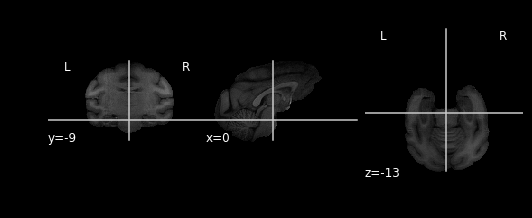

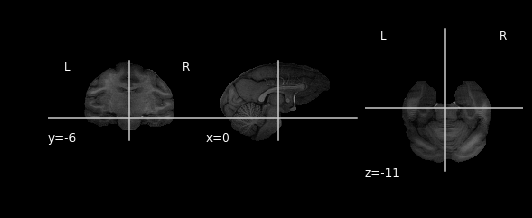

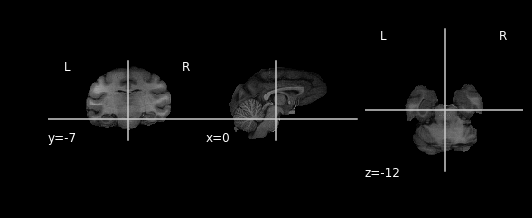

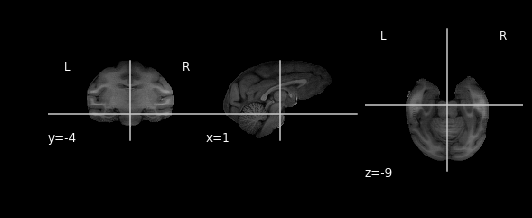

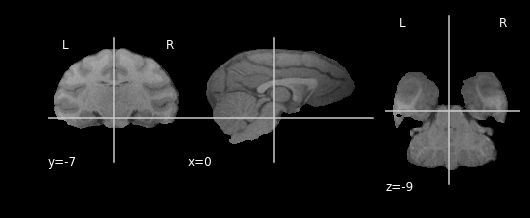

...

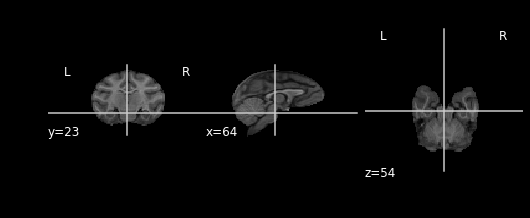

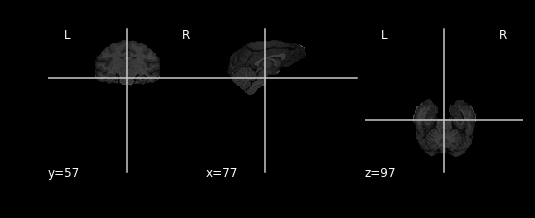

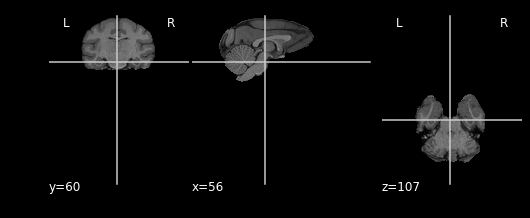

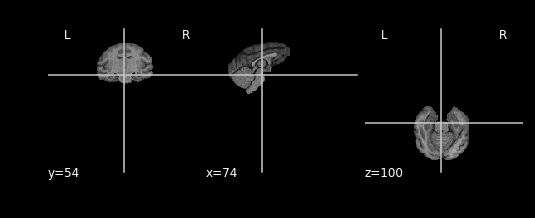

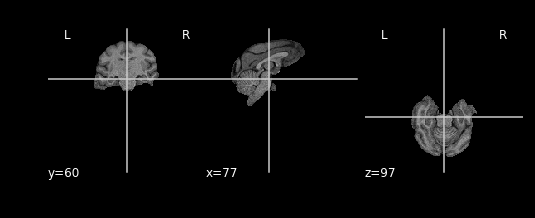

In [8]:
# Read mean PMJ coordinates (previously calculated)
imgs_PMJ = np.loadtxt(os.path.join(out_dir, 'PMJ_coords_mean.txt'))

# Plot brain (with cross at PMJ)
for i, brain in enumerate(subject_brains):
    orig_x, orig_y, orig_z  = imgs_PMJ[i]
    plotting.plot_anat(brain, cut_coords=[orig_x, orig_y, orig_z])

## 2. Register the extracted brains to the NMTv2.0asym template
### 3a. First perform a linear (affine, 12 DOF) registration
The registration will be initialized at the center of image intensities (center of mass)

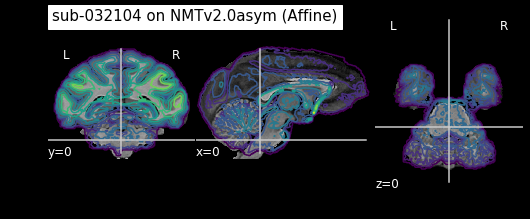

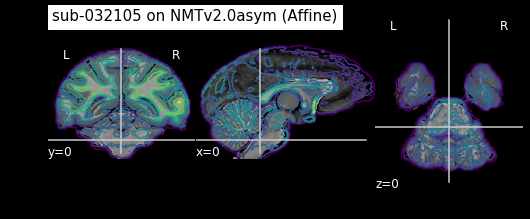

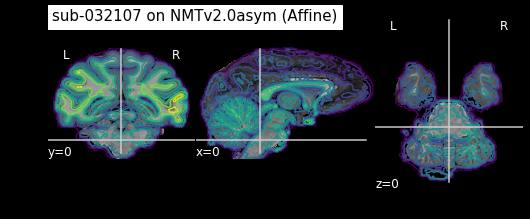

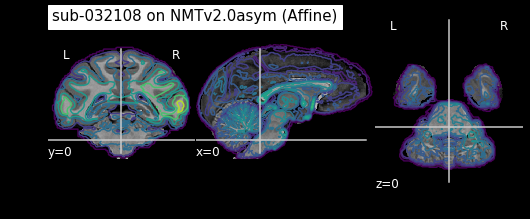

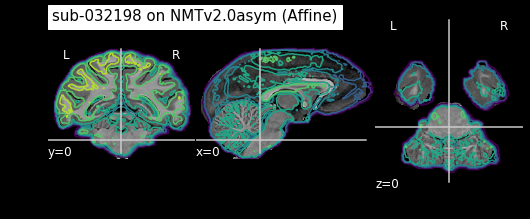

...

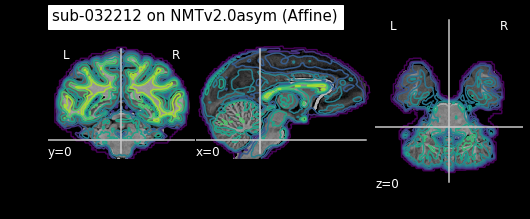

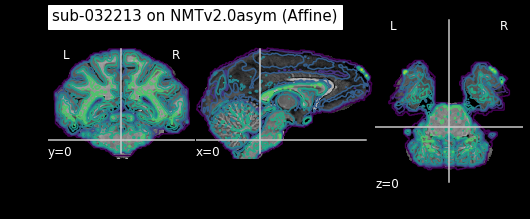

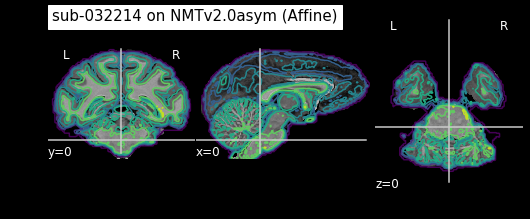

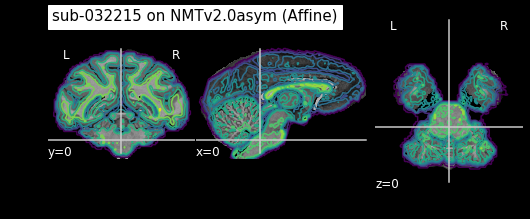

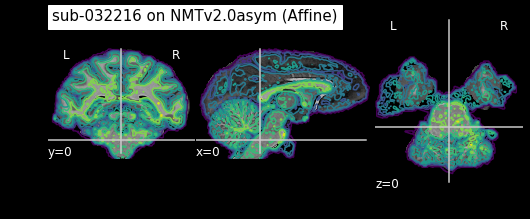

In [13]:
for i, img in enumerate(subject_brains):
    subject = subjects[i]
    register_linear(
        img,
        template,
        f"{out_dir}/{subject}_brain_to_NMTv2.0asym_",
        transform="Affine",
        initialize=1
    )
    img_transformed = f"{out_dir}/{subject}_brain_to_NMTv2.0asym_Affine_Transformed.nii.gz"
    overlay_contours(
        template,
        img_transformed,
        plot_title=f"{subject} on NMTv2.0asym (Affine)",
        save_plot=f"{out_dir}/{subject}_to_NMTv2.0asym_Affine.png",
    )

### 3b. Follow up with non-linear (SyN) registration
The registration will start from the linearly aligned image

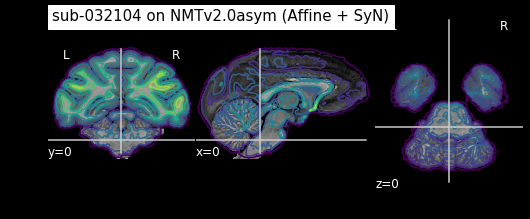

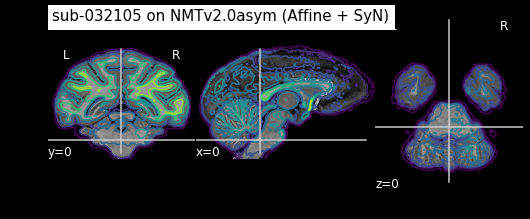

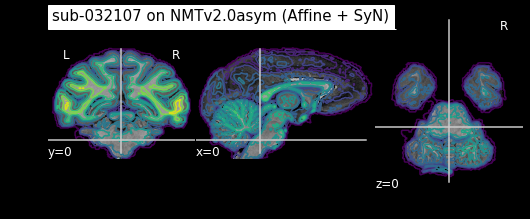

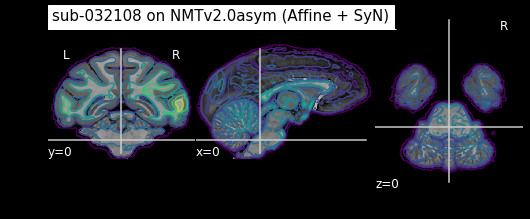

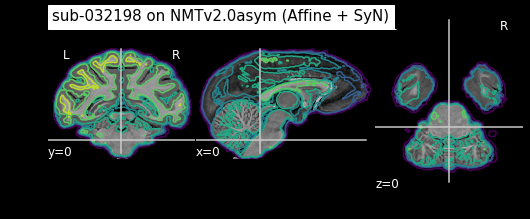

...

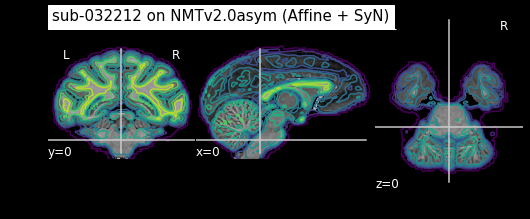

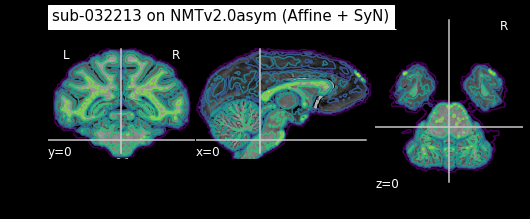

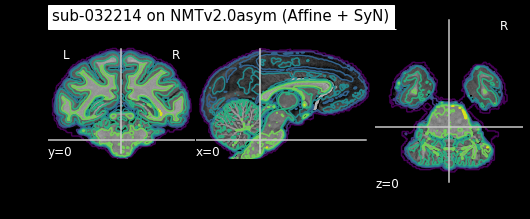

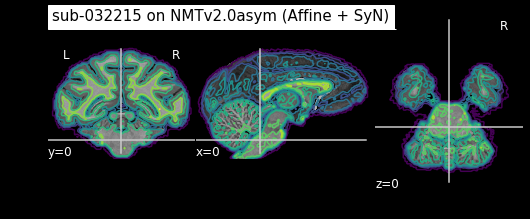

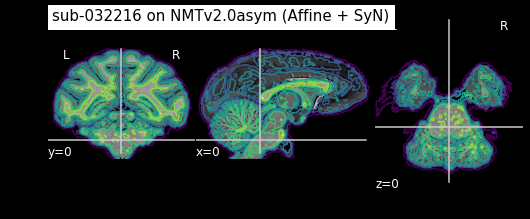

In [14]:
for i, img in enumerate(subject_brains):
    subject = subjects[i]
    img_transformed_aff = f"{out_dir}/{subject}_brain_to_NMTv2.0asym_Affine_Transformed.nii.gz"
    register_SyN(
        img_transformed_aff,
        template,
        f"{out_dir}/{subject}_brain_to_NMTv2.0asym_"
    )
    img_transformed_syn = f"{out_dir}/{subject}_brain_to_NMTv2.0asym_SyN_Transformed.nii.gz"
    overlay_contours(
        template,
        img_transformed_syn,
        plot_title=f"{subject} on NMTv2.0asym (Affine + SyN)",
        save_plot=f"{out_dir}/{subject}_to_NMTv2.0asym_SyN.png",
    )